In [1]:
%matplotlib inline
import os, sys
module_path = os.path.abspath(os.path.join('..'))
if module_path not in sys.path:
    sys.path.append(module_path)
    
from utils.helpers import launch_env, wrap_env, view_results_ipython
from simulation.gym_duckietown.wrappers import SteeringToWheelVelWrapper
import numpy as np
import matplotlib.pyplot as plt

INFO:aido-protocols:aido-protocols 5.0.5
00:11:37|zn|__init__.py:6|<module>(): zn 2.0.3
00:11:37|zj|__init__.py:5|<module>(): zj 2.0.4
00:11:37|gym-duckietown|__init__.py:10|<module>(): gym-duckietown 2019.0.0

00:11:37|gym-duckietown|__init__.py:24|reg_map_env(): Registering gym environment id: Duckietown-loop_pedestrians-v0
00:11:37|gym-duckietown|__init__.py:24|reg_map_env(): Registering gym environment id: Duckietown-small_loop_cw-v0
00:11:37|gym-duckietown|__init__.py:24|reg_map_env(): Registering gym environment id: Duckietown-loop_empty-v0
00:11:37|gym-duckietown|__init__.py:24|reg_map_env(): Registering gym environment id: Duckietown-loop_obstacles-v0
00:11:37|gym-duckietown|__init__.py:24|reg_map_env(): Registering gym environment id: Duckietown-zigzag_dists-v0
00:11:37|gym-duckietown|__init__.py:24|reg_map_env(): Registering gym environment id: Duckietown-straight_road-v0
00:11:37|gym-duckietown|__init__.py:24|reg_map_env(): Registering gym environment id: Duckietown-4way-v0


# Control

In robotics, control is often considered a discipline in its own right. Simply, control theory allows us to map from sensory data (or, some sort of intermediate representation) to actuation commands - these commands can help drive our Duckiebot, fly our planes, and even land our rockets.

For those coming from a machine learning background (or those with familiarity with reinforcement learning and imitation learning), you may have noticed a difference between the control covered in class and the controllers, or *policies*, that you may normally train. In robotics, an important part of control is feedback; Feedback allows our controller to self-regulate and tune, and is an important part of the control process. 

In this exercise, we will cover two controllers: a simple, PD controller, and a slightly more complicated pure-pursuit controller in Part 2. 


## Part 1: PID

A PID controller, named for its components of **Proportional**, **Integral**, and **Derivative**, is a simple yet robust mechanism. This generality has lead to its widespread use across multiple disciplines, and is what our exercise will start with. More eloquently (from Wikipedia): *A PID controller continuously calculates an error value e(t) as the difference between a desired setpoint (SP) and a measured process variable (PV) and applies a correction based on proportional, integral, and derivative terms (denoted P, I, and D respectively), hence the name.*

*In practical terms it automatically applies accurate and responsive correction to a control function.*

In our exercise, we will only implement the **P**ropotional and (an approximation to the) **D**erivative control corrections.

Before we begin with the practical portion, the **first part of the exercise** consists of the following:

*Explain, qualitatively, the difference between the three terms. For the following types of controllers, explain the error terms involved in the correction, and what types of applications they are commonly used for. If these controllers do not exist (or cannot), explain why.*

1. P
2. PI
3. PD
4. ID
5. PID

Put your answers inside of the zip file, inside of a file named **03-control.txt**.

***

As we continue towards the practical portion of the first exercise, we will be tasked with setting up a controller that keeps the Duckiebot on the road. 

In the kinematics exercise, we saw how to translate linear and angular velocity commands into wheel rate. After understanding the conversion, we still need to answer a more important question: *what* commands should we use to control the Duckiebot?

Since we're using a simulation, we are able to access the ground-truth values of two variables that are crucial to help our Duckiebot stay in the lane: $d$, the distance to the center of the lane, and $\omega$, the angle with respect to the lane. 

In your file `notebooks/code/exercise_03_control/controller.py`, complete function `angle_control_commands`. Update `omega` (angular speed) to achieve your goal while keeping `v` constant.

In [2]:
from notebooks.code.exercise_03_control.controller import Controller

# Setting up the environment
local_env = launch_env()
local_env = SteeringToWheelVelWrapper(wrap_env(local_env))
local_env.reset()
local_env.robot_speed = 0.5
total_reward = 0        
controller = Controller()
    
# Starting to drive
error_dist = []
error_angle = []

for _ in range(1000):
    # Getting the pose
    lane_pose = local_env.get_lane_pos2(local_env.cur_pos, local_env.cur_angle)
    dist = lane_pose.dist        # Distance to lane center. Left is negative, right is positive.
    angle = lane_pose.angle_rad  # Angle from straight, in radians. Left is negative, right is positive.
    
    # Control
    v = 0.5  # For now, keep linear velocity constant
    
    omega = controller.angle_control_commands(dist, angle)
    commands = np.array([v, omega])
    
    # Step
    _, r, d, _ = local_env.step(commands)
    total_reward += r
    
    # Store error
    error_dist.append(dist)
    error_angle.append(angle)
    
    if d: 
        print("Duckiebot crashed.")
        break
        
        
local_env.close()

00:11:44|gym-duckietown|graphics.py:125|create_frame_buffers(): Falling back to non-multisampled frame buffer
00:11:44|gym-duckietown|graphics.py:125|create_frame_buffers(): Falling back to non-multisampled frame buffer
00:11:44|gym-duckietown|simulator.py:535|_load_map(): loading map file "/duckietown/simulation/gym_duckietown/maps/loop_empty.yaml"
00:11:44|gym-duckietown|objmesh.py:50|__init__(): loading mesh "duckiebot.obj"
00:11:44|gym-duckietown|objmesh.py:238|_load_mtl(): loading materials from "/duckietown/simulation/gym_duckietown/meshes/duckiebot.mtl"
00:11:44|gym-duckietown|objmesh.py:50|__init__(): loading mesh "duckie.obj"
00:11:44|gym-duckietown|graphics.py:60|load_texture(): loading texture "duckie.png"
00:11:45|gym-duckietown|objmesh.py:50|__init__(): loading mesh "cone.obj"
00:11:45|gym-duckietown|graphics.py:60|load_texture(): loading texture "cone.png"
00:11:45|gym-duckietown|graphics.py:60|load_texture(): loading texture "floor_1.png"
00:11:45|gym-duckietown|graphics

00:11:45|gym-duckietown|simulator.py:1202|_valid_pose(): Invalid pose. Collision free: True On drivable area: False
00:11:45|gym-duckietown|simulator.py:1203|_valid_pose(): safety_factor: 1.3
00:11:45|gym-duckietown|simulator.py:1204|_valid_pose(): pos: [3.59826268 0.         2.08721855]
00:11:45|gym-duckietown|simulator.py:1205|_valid_pose(): l_pos: [3.5894849  0.         2.18432262]
00:11:45|gym-duckietown|simulator.py:1206|_valid_pose(): r_pos: [3.60704045 0.         1.99011448]
00:11:45|gym-duckietown|simulator.py:1207|_valid_pose(): f_pos: [3.48173779 0.         2.07668522]
00:11:45|gym-duckietown|simulator.py:1092|_drivable_pos(): [3.48172154 0.         1.84866924] corresponds to tile at (5, 3) which is not drivable: {'coords': (5, 3), 'kind': 'floor', 'angle': 0, 'drivable': False, 'texture': <simulation.gym_duckietown.graphics.Texture object at 0x7f36050bce10>, 'color': array([1, 1, 1])}
00:11:45|gym-duckietown|simulator.py:1202|_valid_pose(): Invalid pose. Collision free: True

00:11:45|gym-duckietown|simulator.py:1207|_valid_pose(): f_pos: [4.02468139 0.         1.75868687]
00:11:45|gym-duckietown|simulator.py:1092|_drivable_pos(): [3.49620504 0.         2.20742184] corresponds to tile at (5, 3) which is not drivable: {'coords': (5, 3), 'kind': 'floor', 'angle': 0, 'drivable': False, 'texture': <simulation.gym_duckietown.graphics.Texture object at 0x7f36050bce10>, 'color': array([1, 1, 1])}
00:11:45|gym-duckietown|simulator.py:1202|_valid_pose(): Invalid pose. Collision free: True On drivable area: False
00:11:45|gym-duckietown|simulator.py:1203|_valid_pose(): safety_factor: 1.3
00:11:45|gym-duckietown|simulator.py:1204|_valid_pose(): pos: [3.57500004 0.         2.14999713]
00:11:45|gym-duckietown|simulator.py:1205|_valid_pose(): l_pos: [3.49620504 0.         2.20742184]
00:11:45|gym-duckietown|simulator.py:1206|_valid_pose(): r_pos: [3.65379505 0.         2.09257242]
00:11:45|gym-duckietown|simulator.py:1207|_valid_pose(): f_pos: [3.50609039 0.         2.05

00:11:50|gym-duckietown|simulator.py:1202|_valid_pose(): Invalid pose. Collision free: True On drivable area: False
00:11:50|gym-duckietown|simulator.py:1203|_valid_pose(): safety_factor: 1.3
00:11:50|gym-duckietown|simulator.py:1204|_valid_pose(): pos: [2.33703727 0.         2.57700384]
00:11:50|gym-duckietown|simulator.py:1205|_valid_pose(): l_pos: [2.24568806 0.         2.542922  ]
00:11:50|gym-duckietown|simulator.py:1206|_valid_pose(): r_pos: [2.42838647 0.         2.61108568]
00:11:50|gym-duckietown|simulator.py:1207|_valid_pose(): f_pos: [2.37793548 0.         2.46738479]
00:11:50|gym-duckietown|simulator.py:1092|_drivable_pos(): [2.28873639 0.         2.68406941] corresponds to tile at (3, 4) which is not drivable: {'coords': (3, 4), 'kind': 'floor', 'angle': 0, 'drivable': False, 'texture': <simulation.gym_duckietown.graphics.Texture object at 0x7f36050bce10>, 'color': array([1, 1, 1])}
00:11:50|gym-duckietown|simulator.py:1202|_valid_pose(): Invalid pose. Collision free: True

00:11:50|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.26959122 0.         3.10639858] angle 3.057956594355384
00:11:50|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.2463586  0.         3.10471938] angle 3.080924491729476
00:11:50|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.2463586  0.         3.10471938] angle 3.080924491729476
00:11:50|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.22309672 0.         3.10350724] angle 3.0981379753326084
00:11:50|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.22309672 0.         3.10350724] angle 3.0981379753326084
00:11:50|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.19981927 0.         3.10264045] angle 3.1106069334380173
00:11:50|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.19981927 0.         3.10264045] angle 3.1106069334380173
00:11:50|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.1765338  0.         3.10202272] angle 3.1195342733349563
00:11:51|gym-duckietown|sim

00:11:51|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.59419893 0.         3.1005003 ] angle 3.141588256468483
00:11:51|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.59419893 0.         3.1005003 ] angle 3.141588256468483
00:11:51|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.5709052  0.         3.10050022] angle 3.1415895264907907
00:11:51|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.5709052  0.         3.10050022] angle 3.1415895264907907
00:11:51|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.54761146 0.         3.10050015] angle 3.141590429683654
00:11:51|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.54761146 0.         3.10050015] angle 3.141590429683654
00:11:51|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.52431773 0.         3.10050011] angle 3.1415910720128477
00:11:51|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.52431773 0.         3.10050011] angle 3.1415910720128477
00:11:51|gym-duckietown|simu

00:11:52|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.98847269 0.         2.99790684] angle 1.83427626877095
00:11:52|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.98847269 0.         2.99790684] angle 1.83427626877095
00:11:52|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.98387315 0.         2.97508824] angle 1.7051258148373891
00:11:52|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.98387315 0.         2.97508824] angle 1.7051258148373891
00:11:52|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.98194455 0.         2.95188478] angle 1.6023189675569205
00:11:52|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.98194455 0.         2.95188478] angle 1.6023189675569205
00:11:52|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.98213799 0.         2.928598  ] angle 1.5226606876523812
00:11:52|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.98213799 0.         2.928598  ] angle 1.5226606876523812
00:11:52|gym-duckietown|simu

00:11:53|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99449672 0.         2.34669122] angle 1.5707487529457387
00:11:53|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99449672 0.         2.34669122] angle 1.5707487529457387
00:11:53|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99449767 0.         2.32339749] angle 1.5707624938137514
00:11:53|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99449767 0.         2.32339749] angle 1.5707624938137514
00:11:53|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99449834 0.         2.30010376] angle 1.570772265874235
00:11:53|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99449834 0.         2.30010376] angle 1.570772265874235
00:11:53|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99449882 0.         2.27681002] angle 1.5707792154452755
00:11:53|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99449882 0.         2.27681002] angle 1.5707792154452755
00:11:53|gym-duckietown|si

00:11:54|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9945     0.         1.69446667] angle 1.5707963273642214
00:11:54|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9945     0.         1.69446667] angle 1.5707963273642214
00:11:54|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9945     0.         1.67117294] angle 1.5707962929315364
00:11:54|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9945     0.         1.67117294] angle 1.5707962929315364
00:11:54|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99450001 0.         1.64787921] angle 1.570796292798846
00:11:54|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99450001 0.         1.64787921] angle 1.570796292798846
00:11:54|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99450001 0.         1.62458547] angle 1.5707964282535323
00:11:54|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99450001 0.         1.62458547] angle 1.5707964282535323
00:11:54|gym-duckietown|si

00:11:55|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.01843623 0.         1.04633673] angle 1.0262271570170913
00:11:55|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.01843623 0.         1.04633673] angle 1.0262271570170913
00:11:55|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.03225514 0.         1.02762519] angle 0.8431349197391419
00:11:55|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.03225514 0.         1.02762519] angle 0.8431349197391419
00:11:55|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.04930872 0.         1.0118097 ] angle 0.6523622174286114
00:11:55|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.04930872 0.         1.0118097 ] angle 0.6523622174286114
00:11:55|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.06898297 0.         0.99939704] angle 0.4733125558567543
00:11:55|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.06898297 0.         0.99939704] angle 0.4733125558567543
00:11:55|gym-duckietown|

00:11:55|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.62488919 0.         0.99447963] angle -0.0002951645931258923
00:11:55|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.64818292 0.         0.99448552] angle -0.0002099115070259622
00:11:55|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.64818292 0.         0.99448552] angle -0.0002099115070259622
00:11:55|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.67147665 0.         0.9944897 ] angle -0.00014928226874336652
00:11:55|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.67147665 0.         0.9944897 ] angle -0.00014928226874336652
00:11:56|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.69477039 0.         0.99449267] angle -0.00010616471724127642
00:11:56|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.69477039 0.         0.99449267] angle -0.00010616471724127642
00:11:56|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.71806412 0.         0.99449479] angle -7.55009101

00:11:56|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.27711374 0.         0.9945    ] angle -2.3982309789619306e-08
00:11:56|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.27711374 0.         0.9945    ] angle -2.3982309789619306e-08
00:11:56|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.30040747 0.         0.9945    ] angle -1.267296678505155e-08
00:11:56|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.30040747 0.         0.9945    ] angle -1.267296678505155e-08
00:11:56|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.3237012 0.        0.9945   ] angle -9.358127060626756e-09
00:11:56|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.3237012 0.        0.9945   ] angle -9.358127060626756e-09
00:11:56|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.34699494 0.         0.9945    ] angle -1.7758035679698426e-08
00:11:56|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.34699494 0.         0.9945    ] angle -1.775803567969842

00:11:57|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.90604455 0.         0.9945    ] angle -3.250699514084744e-08
00:11:57|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.92933829 0.         0.9945    ] angle -2.2877395553987143e-08
00:11:57|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.92933829 0.         0.9945    ] angle -2.2877395553987143e-08
00:11:57|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.95263202 0.         0.9945    ] angle -1.5980949648718125e-08
00:11:57|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.95263202 0.         0.9945    ] angle -1.5980949648718125e-08
00:11:57|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.97592576 0.         0.9945    ] angle -1.0496709825370987e-08
00:11:57|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.97592576 0.         0.9945    ] angle -1.0496709825370987e-08
00:11:57|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.99921949 0.         0.9945    ] angle -1.889661

00:11:58|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.5582416  0.         0.99557283] angle -0.08110619601146951
00:11:58|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.5582416  0.         0.99557283] angle -0.08110619601146951
00:11:58|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.58131102 0.         0.99871416] angle -0.18956631254441758
00:11:58|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.58131102 0.         0.99871416] angle -0.18956631254441758
00:11:58|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.60383486 0.         1.00458772] angle -0.32061325667343865
00:11:58|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.60383486 0.         1.00458772] angle -0.32061325667343865
00:11:58|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.62528971 0.         1.01359964] angle -0.4747123645968264
00:11:58|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.62528971 0.         1.01359964] angle -0.4747123645968264
00:11:58|g

00:11:59|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68554532 0.         1.56853153] angle -1.5714530651569352
00:11:59|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68554532 0.         1.56853153] angle -1.5714530651569352
00:11:59|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68553223 0.         1.59182526] angle -1.5712633779169891
00:11:59|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68553223 0.         1.59182526] angle -1.5712633779169891
00:11:59|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68552292 0.         1.61511899] angle -1.5711284784528965
00:11:59|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68552292 0.         1.61511899] angle -1.5711284784528965
00:11:59|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.6855163  0.         1.63841272] angle -1.5710325423075595
00:11:59|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.6855163  0.         1.63841272] angle -1.5710325423075595
00:11:59|gym-duc

00:11:59|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.6855     0.         2.22075607] angle -1.570796373420528
00:11:59|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.6855     0.         2.22075607] angle -1.570796373420528
00:11:59|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.6855     0.         2.24404981] angle -1.5707963568320609
00:11:59|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.6855     0.         2.24404981] angle -1.5707963568320609
00:11:59|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.6855     0.         2.26734354] angle -1.5707963477032403
00:12:00|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.6855     0.         2.26734354] angle -1.5707963477032403
00:12:00|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.6855     0.         2.29063727] angle -1.5707963380299685
00:12:00|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.6855     0.         2.29063727] angle -1.5707963380299685
00:12:00|gym-ducki

00:12:00|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.27893915 0.         2.51602426] angle -3.14919019234564
00:12:00|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.27893915 0.         2.51602426] angle -3.14919019234564
00:12:00|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.25564591 0.         2.51587284] angle -3.1469959487817682
00:12:00|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.25564591 0.         2.51587284] angle -3.1469959487817682
00:12:00|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.23235243 0.         2.51576515] angle -3.145435355060491
00:12:00|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.23235243 0.         2.51576515] angle -3.145435355060491
00:12:00|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.20905883 0.         2.51568857] angle -3.1443254752762284
00:12:00|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.20905883 0.         2.51568857] angle -3.1443254752762284
00:12:00|gym-duckietow

00:12:01|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.64707535 0.         2.61000606] angle -2.5303206223661774
00:12:01|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.64707535 0.         2.61000606] angle -2.5303206223661774
00:12:01|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.62823838 0.         2.62370682] angle -2.4951928844913045
00:12:01|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.62823838 0.         2.62370682] angle -2.4951928844913045
00:12:01|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.60962101 0.         2.6377065 ] angle -2.498472190391499
00:12:01|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.60962101 0.         2.6377065 ] angle -2.498472190391499
00:12:01|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.59199579 0.         2.65290845] angle -2.361288006893515
00:12:01|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.59199579 0.         2.65290845] angle -2.361288006893515
00:12:01|gym-duckiet

00:12:02|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.35611301 0.         3.11314357] angle -3.146272862544094
00:12:02|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.35611301 0.         3.11314357] angle -3.146272862544094
00:12:02|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.33284427 0.         3.11218336] angle -3.2193985141236263
00:12:02|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.33284427 0.         3.11218336] angle -3.2193985141236263
00:12:02|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.30965904 0.         3.109951  ] angle -3.2557625526602103
00:12:02|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.30965904 0.         3.109951  ] angle -3.2557625526602103
00:12:02|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.28649394 0.         3.10750943] angle -3.2374444102474076
00:12:02|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.28649394 0.         3.10750943] angle -3.2374444102474076
00:12:02|gym-ducki

00:12:03|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.70432573 0.         3.10050143] angle -3.1416133635366785
00:12:03|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.70432573 0.         3.10050143] angle -3.1416133635366785
00:12:03|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.681032   0.         3.10050102] angle -3.1416073818370878
00:12:03|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.681032   0.         3.10050102] angle -3.1416073818370878
00:12:03|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.65773826 0.         3.10050072] angle -3.141603127840067
00:12:03|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.65773826 0.         3.10050072] angle -3.141603127840067
00:12:03|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.63444453 0.         3.10050051] angle -3.1416001025296882
00:12:03|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.63444453 0.         3.10050051] angle -3.1416001025296882
00:12:03|gym-ducki

00:12:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.05495144 0.         3.08143535] angle -3.615502206575035
00:12:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.05495144 0.         3.08143535] angle -3.615502206575035
00:12:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.03522816 0.         3.06909518] angle -3.785838812832851
00:12:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.03522816 0.         3.06909518] angle -3.785838812832851
00:12:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.01802941 0.         3.05343651] angle -3.974468386045031
00:12:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.01802941 0.         3.05343651] angle -3.974468386045031
00:12:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.00408964 0.         3.03481818] angle -4.164956285152231
00:12:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.00408964 0.         3.03481818] angle -4.164956285152231
00:12:04|gym-duckietown|

00:12:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99448366 0.         2.45680722] angle -4.712625819795907
00:12:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99448366 0.         2.45680722] angle -4.712625819795907
00:12:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99448838 0.         2.43351348] angle -4.712557412908166
00:12:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99448838 0.         2.43351348] angle -4.712557412908166
00:12:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99449173 0.         2.41021975] angle -4.712508764142758
00:12:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99449173 0.         2.41021975] angle -4.712508764142758
00:12:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99449412 0.         2.38692601] angle -4.712474166715947
00:12:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99449412 0.         2.38692601] angle -4.712474166715947
00:12:05|gym-duckietown|

00:12:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9945     0.         1.80458267] angle -4.712388996268413
00:12:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9945     0.         1.80458267] angle -4.712388996268413
00:12:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9945     0.         1.78128893] angle -4.7123889907841745
00:12:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9945     0.         1.78128893] angle -4.7123889907841745
00:12:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9945    0.        1.7579952] angle -4.712388999184083
00:12:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9945    0.        1.7579952] angle -4.712388999184083
00:12:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9945     0.         1.73470146] angle -4.712388983610046
00:12:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9945     0.         1.73470146] angle -4.712388983610046
00:12:05|gym-duckietown|simu

00:12:06|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9945     0.         1.15235811] angle -4.712388989479093
00:12:06|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9945     0.         1.15235811] angle -4.712388989479093
00:12:06|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99515392 0.         1.12907662] angle -4.768549748525034
00:12:06|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99515392 0.         1.12907662] angle -4.768549748525034
00:12:06|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99763483 0.         1.10592537] angle -4.869735213223341
00:12:06|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99763483 0.         1.10592537] angle -4.869735213223341
00:12:06|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.00265934 0.         1.0831944 ] angle -4.9901309611452325
00:12:06|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.00265934 0.         1.0831944 ] angle -4.9901309611452325
00:12:06|gym-duckietow

00:12:07|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.53820401 0.         0.99443027] angle -6.284195831504965
00:12:07|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.53820401 0.         0.99443027] angle -6.284195831504965
00:12:07|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.56149774 0.         0.99445041] angle -6.283903959599596
00:12:07|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.56149774 0.         0.99445041] angle -6.283903959599596
00:12:07|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.58479147 0.         0.99446473] angle -6.2836963895954145
00:12:07|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.58479147 0.         0.99446473] angle -6.2836963895954145
00:12:07|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.6080852  0.         0.99447492] angle -6.283548772475196
00:12:07|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.6080852  0.         0.99447492] angle -6.283548772475196
00:12:07|gym-duckietow

00:12:08|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.19042855 0.         0.9945    ] angle -6.283185377840901
00:12:08|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.19042855 0.         0.9945    ] angle -6.283185377840901
00:12:08|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.21372228 0.         0.9945    ] angle -6.2831853579981525
00:12:08|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.21372228 0.         0.9945    ] angle -6.2831853579981525
00:12:08|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.23701601 0.         0.9945    ] angle -6.283185342165342
00:12:08|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.23701601 0.         0.9945    ] angle -6.283185342165342
00:12:08|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.26030975 0.         0.9945    ] angle -6.2831853317419615
00:12:08|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.26030975 0.         0.9945    ] angle -6.2831853317419615
00:12:08|gym-duckiet

00:12:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.8426531 0.        0.9945   ] angle -6.2831852913338055
00:12:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.8426531 0.        0.9945   ] angle -6.2831852913338055
00:12:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.86594683 0.         0.9945    ] angle -6.283185296262677
00:12:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.86594683 0.         0.9945    ] angle -6.283185296262677
00:12:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.88924057 0.         0.9945    ] angle -6.2831853011915495
00:12:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.88924057 0.         0.9945    ] angle -6.2831853011915495
00:12:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.9125343 0.        0.9945   ] angle -6.283185292236275
00:12:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.9125343 0.        0.9945   ] angle -6.283185292236275
00:12:09|gym-duckietown|simulato

00:12:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.49487765 0.         0.9945    ] angle -6.283185320648005
00:12:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.49487765 0.         0.9945    ] angle -6.283185320648005
00:12:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.51817138 0.         0.9945    ] angle -6.283185315163766
00:12:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.51817138 0.         0.9945    ] angle -6.283185315163766
00:12:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.54146266 0.         0.99479314] angle -6.308355412218014
00:12:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.54146266 0.         0.99479314] angle -6.308355412218014
00:12:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.56469469 0.         0.99638465] angle -6.394812169487082
00:12:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.56469469 0.         0.99638465] angle -6.394812169487082
00:12:09|gym-duckietown|

00:12:10|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68561569 0.         1.5054995 ] angle -7.85565825063675
00:12:10|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68561569 0.         1.5054995 ] angle -7.85565825063675
00:12:10|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68558227 0.         1.52879321] angle -7.85517399061614
00:12:10|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68558227 0.         1.52879321] angle -7.85517399061614
00:12:10|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68555851 0.         1.55208693] angle -7.854829599809347
00:12:10|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68555851 0.         1.55208693] angle -7.854829599809347
00:12:10|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68554161 0.         1.57538065] angle -7.854584679959027
00:12:10|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68554161 0.         1.57538065] angle -7.854584679959027
00:12:10|gym-duckietown|simu

00:12:11|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68550001 0.         2.157724  ] angle -7.853981754486386
00:12:11|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68550001 0.         2.157724  ] angle -7.853981754486386
00:12:11|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68550001 0.         2.18101773] angle -7.853981720304382
00:12:11|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68550001 0.         2.18101773] angle -7.853981720304382
00:12:11|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.6855     0.         2.20431147] angle -7.853981693781123
00:12:11|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.6855     0.         2.20431147] angle -7.853981693781123
00:12:11|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.6855    0.        2.2276052] angle -7.853981677493285
00:12:11|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.6855    0.        2.2276052] angle -7.853981677493285
00:12:11|gym-duckietown|simula

00:12:12|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.341538   0.         2.51682475] angle -9.443969310968596
00:12:12|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.341538   0.         2.51682475] angle -9.443969310968596
00:12:12|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.31824744 0.         2.51644223] angle -9.438431126540074
00:12:12|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.31824744 0.         2.51644223] angle -9.438431126540074
00:12:12|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.29495531 0.         2.51617012] angle -9.434489032648758
00:12:12|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.29495531 0.         2.51617012] angle -9.434489032648758
00:12:12|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.27166239 0.         2.51597658] angle -9.43168456360203
00:12:12|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.27166239 0.         2.51597658] angle -9.43168456360203
00:12:12|gym-duckietown|si

00:12:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.70034045 0.         2.57697231] angle -8.923882272026137
00:12:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.70034045 0.         2.57697231] angle -8.923882272026137
00:12:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.68014064 0.         2.58856935] angle -8.88333363067154
00:12:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.68014064 0.         2.58856935] angle -8.88333363067154
00:12:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.66041858 0.         2.60096165] angle -8.844217353372793
00:12:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.66041858 0.         2.60096165] angle -8.844217353372793
00:12:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.64125329 0.         2.61419748] angle -8.796540275967484
00:12:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.64125329 0.         2.61419748] angle -8.796540275967484
00:12:13|gym-duckietown|si

00:12:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.41876257 0.         3.10478899] angle -9.12407206042691
00:12:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.41876257 0.         3.10478899] angle -9.12407206042691
00:12:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.39615885 0.         3.11036034] angle -9.242159326035244
00:12:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.39615885 0.         3.11036034] angle -9.242159326035244
00:12:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.37304648 0.         3.11313435] angle -9.36849320389491
00:12:14|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.37304648 0.         3.11313435] angle -9.36849320389491
00:12:14|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.349762  0.        3.1134297] angle -9.45569592027582
00:12:14|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.349762  0.        3.1134297] angle -9.45569592027582
00:12:14|gym-duckietown|simulator.py

00:12:14|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.76788078 0.         3.1005037 ] angle -9.424831621486673
00:12:14|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.76788078 0.         3.1005037 ] angle -9.424831621486673
00:12:14|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.74458705 0.         3.10050263] angle -9.424816122533173
00:12:14|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.74458705 0.         3.10050263] angle -9.424816122533173
00:12:14|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.72129332 0.         3.10050187] angle -9.424805100179956
00:12:14|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.72129332 0.         3.10050187] angle -9.424805100179956
00:12:14|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.69799958 0.         3.10050133] angle -9.424797261437684
00:12:14|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.69799958 0.         3.10050133] angle -9.424797261437684
00:12:14|gym-duckietown|

00:12:15|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.11571301 0.         3.09875971] angle -9.531788058788962
00:12:15|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.11571301 0.         3.09875971] angle -9.531788058788962
00:12:15|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.09274267 0.         3.09496733] angle -9.645014269814917
00:12:15|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.09274267 0.         3.09496733] angle -9.645014269814917
00:12:15|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.07046638 0.         3.08823013] angle -9.791925414007341
00:12:15|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.07046638 0.         3.08823013] angle -9.791925414007341
00:12:15|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.04944948 0.         3.0782388 ] angle -9.945171854403196
00:12:15|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.04944948 0.         3.0782388 ] angle -9.945171854403196
00:12:15|gym-duckietown|

00:12:16|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99445782 0.         2.52019171] angle -10.996185582635713
00:12:16|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99445782 0.         2.52019171] angle -10.996185582635713
00:12:16|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99447    0.         2.49689798] angle -10.996009020877274
00:12:16|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99447    0.         2.49689798] angle -10.996009020877274
00:12:16|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99447867 0.         2.47360425] angle -10.99588345583872
00:12:16|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99447867 0.         2.47360425] angle -10.99588345583872
00:12:16|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99448483 0.         2.45031051] angle -10.995794158037407
00:12:16|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99448483 0.         2.45031051] angle -10.995794158037407
00:12:16|gym-ducki

00:12:17|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9945     0.         1.86796716] angle -10.995574333314869
00:12:17|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9945     0.         1.86796716] angle -10.995574333314869
00:12:17|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9945     0.         1.84467343] angle -10.995574321756315
00:12:17|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9945     0.         1.84467343] angle -10.995574321756315
00:12:17|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9945    0.        1.8213797] angle -10.995574312126715
00:12:17|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9945    0.        1.8213797] angle -10.995574312126715
00:12:17|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9945     0.         1.79808596] angle -10.99557430081737
00:12:17|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9945     0.         1.79808596] angle -10.99557430081737
00:12:17|gym-duckietown|

00:12:18|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9945     0.         1.21574261] angle -10.995574296801873
00:12:18|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9945     0.         1.21574261] angle -10.995574296801873
00:12:18|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9945     0.         1.19244888] angle -10.995574305201782
00:12:18|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9945     0.         1.19244888] angle -10.995574305201782
00:12:18|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9945     0.         1.16915514] angle -10.995574299717543
00:12:18|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9945     0.         1.16915514] angle -10.995574299717543
00:12:18|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99452134 0.         1.14586142] angle -10.997406833607872
00:12:18|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99452134 0.         1.14586142] angle -10.997406833607872
00:12:18|gym-duc

00:12:19|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.47453882 0.         0.99432154] angle -12.568956937184083
00:12:19|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.47453882 0.         0.99432154] angle -12.568956937184083
00:12:19|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.4978325  0.         0.99437309] angle -12.568209927959785
00:12:19|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.4978325  0.         0.99437309] angle -12.568209927959785
00:12:19|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.5211262  0.         0.99440974] angle -12.567678676172136
00:12:19|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.5211262  0.         0.99440974] angle -12.567678676172136
00:12:19|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.54441992 0.         0.99443581] angle -12.567300866094282
00:12:19|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.54441992 0.         0.99443581] angle -12.567300866094282
00:12:19|gym-duc

00:12:19|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.12676326 0.         0.99449999] angle -12.566370799760593
00:12:19|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.12676326 0.         0.99449999] angle -12.566370799760593


You can see how well you are doing:

In [3]:
print("Your score: {}".format(total_reward))
view_results_ipython(local_env)

Your score: 663.4509321699895


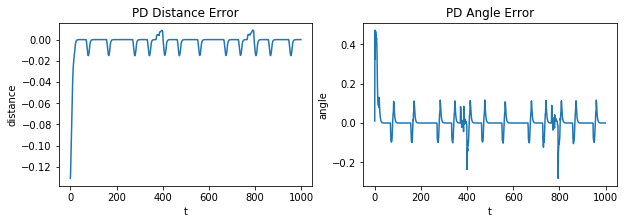

In [4]:
# Plot error

'''Plot distribution'''
plt.figure(figsize = (10,3))

plt.subplot(121)
plt.plot(error_dist)
plt.xlabel('t')
plt.ylabel('distance')
plt.title('PD Distance Error')

plt.subplot(122)
plt.plot(error_angle)
plt.xlabel('t')
plt.ylabel('angle')
plt.title('PD Angle Error')

plt.show()

Within **03-control.txt**, answer the following question:

*Describe the method you used. What kind of controller is it?*

Then, from the list of popular variants of PID controllers, implement a second one. Answer the above question again, and then discuss the differences (both in terms of algorithm and performance) between the two. Do you see any qualitative differences in the driving? Why or why not? Put your answers in **03-control.txt**.

Lastly, for both implementation, plot the **cross-track** error and the **angle error**, and submit the plot(s) (depending on if you decide to separate the metrics on two plots) in the zip file. 

In [5]:
'''Now, lets implement PI controller'''

from notebooks.code.exercise_03_control.controller import Controller

# Setting up the environment
local_env = launch_env()
local_env = SteeringToWheelVelWrapper(wrap_env(local_env))
local_env.reset()
local_env.robot_speed = 0.5
total_reward = 0        
controller = Controller()
    
# Starting to drive
error_dist = []
error_angle = []
error_dist_saturated = []

for _ in range(1000):
    # Getting the pose
    lane_pose = local_env.get_lane_pos2(local_env.cur_pos, local_env.cur_angle)
    dist = lane_pose.dist        # Distance to lane center. Left is negative, right is positive.
    angle = lane_pose.angle_rad  # Angle from straight, in radians. Left is negative, right is positive.
    
    # Store error
    error_dist.append(dist)
    error_angle.append(angle)
    
    # Control
    v = 0.5  # For now, keep linear velocity constant
    kp_dist = 20.
    kp_angle = 20.
    kd_dist = 0.
    kd_angle = 0.
    ki_dist = 10.
    ki_angle = 10.
    omega = controller.pid_control_commands(dist, angle, kp_dist, kp_angle, kd_dist, kd_angle, ki_dist, ki_angle)
    commands = np.array([v, omega])
    
    # Step
    _, r, d, _ = local_env.step(commands)
    total_reward += r
    
    
    
    if d: 
        print("Duckiebot crashed.")
        break
        
        
local_env.close()

00:13:25|gym-duckietown|graphics.py:125|create_frame_buffers(): Falling back to non-multisampled frame buffer
00:13:25|gym-duckietown|graphics.py:125|create_frame_buffers(): Falling back to non-multisampled frame buffer
00:13:25|gym-duckietown|simulator.py:535|_load_map(): loading map file "/duckietown/simulation/gym_duckietown/maps/loop_empty.yaml"
00:13:25|gym-duckietown|simulator.py:1092|_drivable_pos(): [4.13719561 0.         1.88880899] corresponds to tile at (7, 3) which is not drivable: {'coords': (7, 3), 'kind': 'floor', 'angle': 0, 'drivable': False, 'texture': <simulation.gym_duckietown.graphics.Texture object at 0x7f36050bce10>, 'color': array([1, 1, 1])}
00:13:25|gym-duckietown|simulator.py:1202|_valid_pose(): Invalid pose. Collision free: True On drivable area: False
00:13:25|gym-duckietown|simulator.py:1203|_valid_pose(): safety_factor: 1.3
00:13:25|gym-duckietown|simulator.py:1204|_valid_pose(): pos: [4.0873995 0.        1.9726338]
00:13:25|gym-duckietown|simulator.py:12

00:13:25|gym-duckietown|simulator.py:1202|_valid_pose(): Invalid pose. Collision free: True On drivable area: False
00:13:25|gym-duckietown|simulator.py:1203|_valid_pose(): safety_factor: 1.3
00:13:25|gym-duckietown|simulator.py:1204|_valid_pose(): pos: [3.57292165 0.         1.88314807]
00:13:25|gym-duckietown|simulator.py:1205|_valid_pose(): l_pos: [3.48172154 0.         1.84866924]
00:13:25|gym-duckietown|simulator.py:1206|_valid_pose(): r_pos: [3.66412176 0.         1.91762689]
00:13:25|gym-duckietown|simulator.py:1207|_valid_pose(): f_pos: [3.61429624 0.         1.77370793]
00:13:25|gym-duckietown|simulator.py:1092|_drivable_pos(): [3.50690495 0.         2.23654429] corresponds to tile at (5, 3) which is not drivable: {'coords': (5, 3), 'kind': 'floor', 'angle': 0, 'drivable': False, 'texture': <simulation.gym_duckietown.graphics.Texture object at 0x7f36050bce10>, 'color': array([1, 1, 1])}
00:13:25|gym-duckietown|simulator.py:1202|_valid_pose(): Invalid pose. Collision free: True

00:13:25|gym-duckietown|simulator.py:1207|_valid_pose(): f_pos: [3.50609039 0.         2.05544313]
00:13:25|gym-duckietown|simulator.py:1092|_drivable_pos(): [4.12972415 0.         2.27350789] corresponds to tile at (7, 3) which is not drivable: {'coords': (7, 3), 'kind': 'floor', 'angle': 0, 'drivable': False, 'texture': <simulation.gym_duckietown.graphics.Texture object at 0x7f36050bce10>, 'color': array([1, 1, 1])}
00:13:25|gym-duckietown|simulator.py:1202|_valid_pose(): Invalid pose. Collision free: True On drivable area: False
00:13:25|gym-duckietown|simulator.py:1203|_valid_pose(): safety_factor: 1.3
00:13:25|gym-duckietown|simulator.py:1204|_valid_pose(): pos: [4.022444   0.         2.32019802]
00:13:25|gym-duckietown|simulator.py:1205|_valid_pose(): l_pos: [3.98353555 0.         2.23079789]
00:13:25|gym-duckietown|simulator.py:1206|_valid_pose(): r_pos: [4.06135244 0.         2.40959815]
00:13:25|gym-duckietown|simulator.py:1207|_valid_pose(): f_pos: [4.12972415 0.         2.27

00:13:29|gym-duckietown|simulator.py:1092|_drivable_pos(): [2.28873639 0.         2.68406941] corresponds to tile at (3, 4) which is not drivable: {'coords': (3, 4), 'kind': 'floor', 'angle': 0, 'drivable': False, 'texture': <simulation.gym_duckietown.graphics.Texture object at 0x7f36050bce10>, 'color': array([1, 1, 1])}
00:13:29|gym-duckietown|simulator.py:1202|_valid_pose(): Invalid pose. Collision free: True On drivable area: False
00:13:29|gym-duckietown|simulator.py:1203|_valid_pose(): safety_factor: 1.3
00:13:29|gym-duckietown|simulator.py:1204|_valid_pose(): pos: [2.38071712 0.         2.71640816]
00:13:29|gym-duckietown|simulator.py:1205|_valid_pose(): l_pos: [2.28873639 0.         2.68406941]
00:13:29|gym-duckietown|simulator.py:1206|_valid_pose(): r_pos: [2.47269785 0.         2.74874692]
00:13:29|gym-duckietown|simulator.py:1207|_valid_pose(): f_pos: [2.41952363 0.         2.60603129]
00:13:29|gym-duckietown|simulator.py:516|reset(): Starting at [2.64153703 0.         2.8846

00:13:30|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.27216298 0.         3.17289388] angle 3.0376842628945195
00:13:30|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.27216298 0.         3.17289388] angle 3.0376842628945195
00:13:30|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.24895855 0.         3.17086872] angle 3.071393437544225
00:13:30|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.24895855 0.         3.17086872] angle 3.071393437544225
00:13:30|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.22570815 0.         3.16945418] angle 3.090262858425122
00:13:30|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.22570815 0.         3.16945418] angle 3.090262858425122
00:13:30|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.20244361 0.         3.16828844] angle 3.0927897357122514
00:13:30|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.20244361 0.         3.16828844] angle 3.0927897357122514
00:13:30|gym-duckietown|simu

00:13:31|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.62088245 0.         3.13852674] angle 3.1036223839992023
00:13:31|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.62088245 0.         3.13852674] angle 3.1036223839992023
00:13:31|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.59760512 0.         3.13765258] angle 3.104490185798649
00:13:31|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.59760512 0.         3.13765258] angle 3.104490185798649
00:13:31|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.57432706 0.         3.13679839] angle 3.1053376009909734
00:13:31|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.57432706 0.         3.13679839] angle 3.1053376009909734
00:13:31|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.55104828 0.         3.13596372] angle 3.106167984788698
00:13:31|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.55104828 0.         3.13596372] angle 3.106167984788698
00:13:31|gym-duckietown|simu

00:13:32|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9966895  0.         3.04550928] angle 2.082459799234405
00:13:32|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9966895  0.         3.04550928] angle 2.082459799234405
00:13:32|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9868697  0.         3.02441131] angle 1.9303687376928613
00:13:32|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9868697  0.         3.02441131] angle 1.9303687376928613
00:13:32|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9802049  0.         3.00211077] angle 1.7920495276180899
00:13:32|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9802049  0.         3.00211077] angle 1.7920495276180899
00:13:32|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.97638251 0.         2.97914528] angle 1.6794007523616101
00:13:32|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.97638251 0.         2.97914528] angle 1.6794007523616101
00:13:32|gym-duckietown|si

00:13:32|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.98514164 0.         2.39710289] angle 1.5615905863676611
00:13:32|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.98514164 0.         2.39710289] angle 1.5615905863676611
00:13:32|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.98535445 0.         2.37381013] angle 1.5617302106322426
00:13:33|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.98535445 0.         2.37381013] angle 1.5617302106322426
00:13:33|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.98556404 0.         2.35051734] angle 1.5618669224987227
00:13:33|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.98556404 0.         2.35051734] angle 1.5618669224987227
00:13:33|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.98577008 0.         2.32722451] angle 1.5620345308740626
00:13:33|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.98577008 0.         2.32722451] angle 1.5620345308740626
00:13:33|gym-duckietown|

00:13:33|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.98962113 0.         1.74489426] angle 1.5659232312943618
00:13:33|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.98962113 0.         1.74489426] angle 1.5659232312943618
00:13:33|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.98973334 0.         1.72160079] angle 1.566035305866992
00:13:33|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.98973334 0.         1.72160079] angle 1.566035305866992
00:13:33|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.98984297 0.         1.69830732] angle 1.5661448145102161
00:13:33|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.98984297 0.         1.69830732] angle 1.5661448145102161
00:13:33|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.98995007 0.         1.67501383] angle 1.566251805061396
00:13:33|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.98995007 0.         1.67501383] angle 1.566251805061396
00:13:33|gym-duckietown|simu

00:13:34|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99770566 0.         1.09311415] angle 1.32679453165553
00:13:34|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99770566 0.         1.09311415] angle 1.32679453165553
00:13:34|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.0052629  0.         1.07111134] angle 1.153112221739466
00:13:34|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.0052629  0.         1.07111134] angle 1.153112221739466
00:13:34|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.0164199  0.         1.05069341] angle 0.988281799883973
00:13:34|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.0164199  0.         1.05069341] angle 0.988281799883973
00:13:34|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.03088423 0.         1.03247346] angle 0.8113233916302154
00:13:34|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.03088423 0.         1.03247346] angle 0.8113233916302154
00:13:34|gym-duckietown|simulato

00:13:35|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.60192946 0.         0.9942673 ] angle -0.0007346995284809254
00:13:35|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.60192946 0.         0.9942673 ] angle -0.0007346995284809254
00:13:35|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.62522319 0.         0.99428094] angle -0.00043603286447186
00:13:35|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.62522319 0.         0.99428094] angle -0.00043603286447186
00:13:35|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.64851692 0.         0.99428798] angle -0.00016907505143255627
00:13:35|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.64851692 0.         0.99428798] angle -0.00016907505143255627
00:13:35|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.67181065 0.         0.99429046] angle -4.320838717021189e-05
00:13:35|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.67181065 0.         0.99429046] angle -4.32083871702118

00:13:36|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.23086026 0.         0.99437721] angle -0.00012260407190594795
00:13:36|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.254154   0.         0.99438003] angle -0.00011971827656915874
00:13:36|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.254154   0.         0.99438003] angle -0.00011971827656915874
00:13:36|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.27744773 0.         0.99438279] angle -0.00011697734006786286
00:13:36|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.27744773 0.         0.99438279] angle -0.00011697734006786286
00:13:36|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.30074146 0.         0.99438549] angle -0.00011433693267948781
00:13:36|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.30074146 0.         0.99438549] angle -0.00011433693267948781
00:13:36|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.3240352  0.         0.99438812] angle -0.00011

00:13:37|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.88308481 0.         0.99443599] angle -6.393256833001682e-05
00:13:37|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.88308481 0.         0.99443599] angle -6.393256833001682e-05
00:13:37|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.90637855 0.         0.99443746] angle -6.246224215783663e-05
00:13:37|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.90637855 0.         0.99443746] angle -6.246224215783663e-05
00:13:37|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.92967228 0.         0.9944389 ] angle -6.102571515899311e-05
00:13:37|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.92967228 0.         0.9944389 ] angle -6.102571515899311e-05
00:13:37|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.95296601 0.         0.99444031] angle -5.962221342517046e-05
00:13:37|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.95296601 0.         0.99444031] angle -5.962221342517

00:13:37|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.51201563 0.         0.99446585] angle -3.411092434172026e-05
00:13:37|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.53530924 0.         0.99453066] angle -0.0055303306558385935
00:13:37|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.53530924 0.         0.99453066] angle -0.0055303306558385935
00:13:37|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.55857588 0.         0.99553399] angle -0.08066256146249906
00:13:37|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.55857588 0.         0.99553399] angle -0.08066256146249906
00:13:37|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.58161667 0.         0.998853  ] angle -0.20546816652172872
00:13:37|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.58161667 0.         0.998853  ] angle -0.20546816652172872
00:13:37|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.60395246 0.         1.00537899] angle -0.36305916405373206
00

00:13:38|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68460639 0.         1.52943023] angle -1.5692043521872312
00:13:38|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68463289 0.         1.55272395] angle -1.5701123255737428
00:13:38|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68463289 0.         1.55272395] angle -1.5701123255737428
00:13:38|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68464403 0.         1.57601768] angle -1.5705243429441285
00:13:38|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68464403 0.         1.57601768] angle -1.5705243429441285
00:13:38|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68465091 0.         1.59931142] angle -1.5704775341028825
00:13:38|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68465091 0.         1.59931142] angle -1.5704775341028825
00:13:38|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68466147 0.         1.62260515] angle -1.5702086855461195
00:13:38|gym-duc

00:13:39|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.6850233  0.         2.18165464] angle -1.5703205032207845
00:13:39|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68503426 0.         2.20494837] angle -1.5703312712490296
00:13:39|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68503426 0.         2.20494837] angle -1.5703312712490296
00:13:39|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68504497 0.         2.22824211] angle -1.570341806991501
00:13:39|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68504497 0.         2.22824211] angle -1.570341806991501
00:13:39|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68505543 0.         2.25153584] angle -1.5703521843325317
00:13:39|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68505543 0.         2.25153584] angle -1.5703521843325317
00:13:39|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68506566 0.         2.27482957] angle -1.5703624051764062
00:13:39|gym-ducki

00:13:40|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.30933273 0.         2.51395682] angle -3.1452520974727523
00:13:40|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.28603924 0.         2.51385044] angle -3.147066862677391
00:13:40|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.28603924 0.         2.51385044] angle -3.147066862677391
00:13:40|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.26274573 0.         2.51375087] angle -3.144667832141252
00:13:40|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.26274573 0.         2.51375087] angle -3.144667832141252
00:13:40|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.23945202 0.         2.51372088] angle -3.141092535716036
00:13:40|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.23945202 0.         2.51372088] angle -3.141092535716036
00:13:40|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.21615833 0.         2.51376187] angle -3.1385730501955673
00:13:40|gym-duckietow

00:13:41|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.67308827 0.         2.59463639] angle -2.5883832227153705
00:13:41|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.65359823 0.         2.60738836] angle -2.536043899333627
00:13:41|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.65359823 0.         2.60738836] angle -2.536043899333627
00:13:41|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.63477655 0.         2.62110824] angle -2.487369391956509
00:13:41|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.63477655 0.         2.62110824] angle -2.487369391956509
00:13:41|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.61631259 0.         2.63530964] angle -2.484537172055899
00:13:41|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.61631259 0.         2.63530964] angle -2.484537172055899
00:13:41|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.59842962 0.         2.65022722] angle -2.408174805068988
00:13:41|gym-duckietown

00:13:41|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.37520327 0.         3.10111425] angle -3.0976611707067474
00:13:41|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.3519153  0.         3.10129832] angle -3.169716289820898
00:13:41|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.3519153  0.         3.10129832] angle -3.169716289820898
00:13:41|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.32865453 0.         3.10009997] angle -3.216413814362735
00:13:42|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.32865453 0.         3.10009997] angle -3.216413814362735
00:13:42|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.30543063 0.         3.09829792] angle -3.221650536315654
00:13:42|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.30543063 0.         3.09829792] angle -3.221650536315654
00:13:42|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.28218276 0.         3.09685761] angle -3.185285238491563
00:13:42|gym-duckietown

00:13:42|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.72316059 0.         3.0987048 ] angle -3.139848890610364
00:13:42|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.69986689 0.         3.09874521] angle -3.139866436691521
00:13:42|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.69986689 0.         3.09874521] angle -3.139866436691521
00:13:42|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.67657319 0.         3.09878525] angle -3.1398813255398546
00:13:42|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.67657319 0.         3.09878525] angle -3.1398813255398546
00:13:42|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.65327949 0.         3.09882482] angle -3.1399063348068728
00:13:42|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.65327949 0.         3.09882482] angle -3.1399063348068728
00:13:42|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.62998578 0.         3.09886367] angle -3.139943317531776
00:13:42|gym-duckiet

00:13:43|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.07254815 0.         3.08675486] angle -3.553528394965671
00:13:43|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.05209096 0.         3.07567287] angle -3.7225789372666314
00:13:43|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.05209096 0.         3.07567287] angle -3.7225789372666314
00:13:43|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.03391347 0.         3.06116005] angle -3.9081291359122363
00:13:43|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.03391347 0.         3.06116005] angle -3.9081291359122363
00:13:43|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.01875236 0.         3.04352107] angle -4.096655436040431
00:13:43|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.01875236 0.         3.04352107] angle -4.096655436040431
00:13:43|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.00716888 0.         3.02335153] angle -4.285497381485714
00:13:43|gym-duckiet

00:13:44|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9959603  0.         2.46645062] angle -4.711098938237066
00:13:44|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99592768 0.         2.44315691] angle -4.710878266544037
00:13:44|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99592768 0.         2.44315691] angle -4.710878266544037
00:13:44|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99589175 0.         2.41986321] angle -4.710814278891461
00:13:44|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99589175 0.         2.41986321] angle -4.710814278891461
00:13:44|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99585586 0.         2.3965695 ] angle -4.71088207633029
00:13:44|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99585586 0.         2.3965695 ] angle -4.71088207633029
00:13:44|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99582219 0.         2.37327579] angle -4.711005378466145
00:13:44|gym-duckietown|si

00:13:45|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99525752 0.         1.81422647] angle -4.711632269859901
00:13:45|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9952401  0.         1.79093274] angle -4.711649728598396
00:13:45|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9952401  0.         1.79093274] angle -4.711649728598396
00:13:45|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99522308 0.         1.76763901] angle -4.711666776412852
00:13:45|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99522308 0.         1.76763901] angle -4.711666776412852
00:13:45|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99520645 0.         1.74434528] angle -4.711683405195154
00:13:45|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99520645 0.         1.74434528] angle -4.711683405195154
00:13:45|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9951902  0.         1.72105155] angle -4.711699627605852
00:13:45|gym-duckietown|

00:13:46|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99489488 0.         1.16200202] angle -4.7119945732112996
00:13:46|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99512502 0.         1.13870983] angle -4.732544480015844
00:13:46|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99512502 0.         1.13870983] angle -4.732544480015844
00:13:46|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99659705 0.         1.11546988] angle -4.818745298824365
00:13:46|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99659705 0.         1.11546988] angle -4.818745298824365
00:13:46|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.00062258 0.         1.09254456] angle -4.953675013688634
00:13:46|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.00062258 0.         1.09254456] angle -4.953675013688634
00:13:46|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.00812299 0.         1.07052241] angle -5.127627960947029
00:13:46|gym-duckietown

00:13:47|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.53612422 0.         0.99536516] angle -6.2818632346877505
00:13:47|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.55941794 0.         0.9953443 ] angle -6.282715655938518
00:13:47|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.55941794 0.         0.9953443 ] angle -6.282715655938518
00:13:47|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.58271167 0.         0.99533674] angle -6.283006139708911
00:13:47|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.58271167 0.         0.99533674] angle -6.283006139708911
00:13:47|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.60600541 0.         0.99533085] angle -6.282858468508063
00:13:47|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.60600541 0.         0.99533085] angle -6.282858468508063
00:13:47|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.62929914 0.         0.99531961] angle -6.2825475345972075
00:13:47|gym-duckietow

00:13:47|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.18834864 0.         0.99496481] angle -6.2827213454044175
00:13:47|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.21164237 0.         0.99495412] angle -6.282731818196264
00:13:47|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.21164237 0.         0.99495412] angle -6.282731818196264
00:13:47|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.2349361  0.         0.99494368] angle -6.282742095668884
00:13:47|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.2349361  0.         0.99494368] angle -6.282742095668884
00:13:47|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.25822983 0.         0.99493347] angle -6.282752233690546
00:13:47|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.25822983 0.         0.99493347] angle -6.282752233690546
00:13:47|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.28152356 0.         0.9949235 ] angle -6.2827622181119125
00:13:47|gym-duckietow

00:13:48|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.84057315 0.         0.99474229] angle -6.282943303599895
00:13:48|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.86386688 0.         0.99473672] angle -6.282948869337578
00:13:48|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.86386688 0.         0.99473672] angle -6.282948869337578
00:13:48|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.88716062 0.         0.99473127] angle -6.2829543070893195
00:13:48|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.88716062 0.         0.99473127] angle -6.2829543070893195
00:13:48|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.91045435 0.         0.99472596] angle -6.282959619773542
00:13:48|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.91045435 0.         0.99472596] angle -6.282959619773542
00:13:48|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.93374808 0.         0.99472076] angle -6.282964810257367
00:13:48|gym-duckietow

00:13:49|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.49279769 0.         0.9946263 ] angle -6.283059156938415
00:13:49|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.51609142 0.         0.9946234 ] angle -6.283062058205687
00:13:49|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.51609142 0.         0.9946234 ] angle -6.283062058205687
00:13:49|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.5393841  0.         0.99481529] angle -6.299784706212039
00:13:49|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.5393841  0.         0.99481529] angle -6.299784706212039
00:13:49|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.56263155 0.         0.99617165] angle -6.383142935104409
00:13:49|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.56263155 0.         0.99617165] angle -6.383142935104409
00:13:49|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.5855852  0.         1.00003457] angle -6.516687035853162
00:13:49|gym-duckietown|

00:13:50|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68417833 0.         1.51116033] angle -7.851118497413182
00:13:50|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.684232 0.       1.534454] angle -7.85223668150698
00:13:50|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.684232 0.       1.534454] angle -7.85223668150698
00:13:50|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68426281 0.         1.55774771] angle -7.853081134615852
00:13:50|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68426281 0.         1.55774771] angle -7.853081134615852
00:13:50|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68428019 0.         1.58104144] angle -7.853389676706116
00:13:50|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68428019 0.         1.58104144] angle -7.853389676706116
00:13:50|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68429537 0.         1.60433517] angle -7.853270075118564
00:13:50|gym-duckietown|simulator.py:1

00:13:51|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68481018 0.         2.16338454] angle -7.853293020464806
00:13:51|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68482604 0.         2.18667827] angle -7.853308757874071
00:13:51|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68482604 0.         2.18667827] angle -7.853308757874071
00:13:51|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68484153 0.         2.209972  ] angle -7.853324044504761
00:13:51|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68484153 0.         2.209972  ] angle -7.853324044504761
00:13:51|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68485668 0.         2.23326573] angle -7.853339019452959
00:13:51|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68485668 0.         2.23326573] angle -7.853339019452959
00:13:51|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68487147 0.         2.25655946] angle -7.853353742156577
00:13:51|gym-duckietown|

00:13:51|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.32819584 0.         2.51472771] angle -9.4229579442407
00:13:51|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.30490221 0.         2.51468186] angle -9.430535320433629
00:13:52|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.30490221 0.         2.51468186] angle -9.430535320433629
00:13:52|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.28160893 0.         2.51453654] angle -9.431497864990243
00:13:52|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.28160893 0.         2.51453654] angle -9.431497864990243
00:13:52|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.25831552 0.         2.5144165 ] angle -9.428364797329538
00:13:52|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.25831552 0.         2.5144165 ] angle -9.428364797329538
00:13:52|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.23502183 0.         2.51437843] angle -9.424459629515582
00:13:52|gym-duckietown|si

00:13:52|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.68934802 0.         2.58558608] angle -8.90848777961408
00:13:52|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.66938925 0.         2.59759152] angle -8.858006573654718
00:13:52|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.66938925 0.         2.59759152] angle -8.858006573654718
00:13:52|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.65003375 0.         2.61054783] angle -8.811783143833622
00:13:52|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.65003375 0.         2.61054783] angle -8.811783143833622
00:13:52|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.63124826 0.         2.62431861] angle -8.772638860424852
00:13:52|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.63124826 0.         2.62431861] angle -8.772638860424852
00:13:52|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.61272328 0.         2.63844032] angle -8.774255484471624
00:13:52|gym-duckietown|s

00:13:53|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.39399143 0.         3.0996683 ] angle -9.290232311431025
00:13:53|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.37078658 0.         3.10157442] angle -9.395405061009859
00:13:53|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.37078658 0.         3.10157442] angle -9.395405061009859
00:13:53|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.34749759 0.         3.10146627] angle -9.463438868063813
00:13:53|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.34749759 0.         3.10146627] angle -9.463438868063813
00:13:53|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.32424905 0.         3.10004734] angle -9.508031798645742
00:13:53|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.32424905 0.         3.10004734] angle -9.508031798645742
00:13:53|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.30103065 0.         3.09817588] angle -9.50238136697612
00:13:53|gym-duckietown|s

00:13:54|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.74204543 0.         3.09877919] angle -9.423112149538783
00:13:54|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.71875172 0.         3.09881761] angle -9.423144964901583
00:13:54|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.71875172 0.         3.09881761] angle -9.423144964901583
00:13:54|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.69545802 0.         3.0988555 ] angle -9.423157379933494
00:13:54|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.69545802 0.         3.0988555 ] angle -9.423157379933494
00:13:54|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.67216432 0.         3.0988931 ] angle -9.423170523200065
00:13:54|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.67216432 0.         3.0988931 ] angle -9.423170523200065
00:13:54|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.64887061 0.         3.09893025] angle -9.423195308798563
00:13:54|gym-duckietown|

00:13:55|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.09033547 0.         3.09312008] angle -9.686585750525962
00:13:55|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.06844    0.         3.08525026] angle -9.853066229923598
00:13:55|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.06844    0.         3.08525026] angle -9.853066229923598
00:13:55|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.04822068 0.         3.07374608] angle -10.03107104996907
00:13:55|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.04822068 0.         3.07374608] angle -10.03107104996907
00:13:55|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.03048443 0.         3.0587022 ] angle -10.225380175305663
00:13:55|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.03048443 0.         3.0587022 ] angle -10.225380175305663
00:13:55|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.01603894 0.         3.040478  ] angle -10.42527733111738
00:13:55|gym-duckietow

00:13:56|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99557692 0.         2.48592178] angle -10.99499223954892
00:13:56|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99555955 0.         2.46262805] angle -10.99466535424244
00:13:56|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99555955 0.         2.46262805] angle -10.99466535424244
00:13:56|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99553562 0.         2.43933433] angle -10.99442867688051
00:13:56|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99553562 0.         2.43933433] angle -10.99442867688051
00:13:56|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99550819 0.         2.41604061] angle -10.99436464964848
00:13:56|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99550819 0.         2.41604061] angle -10.99436464964848
00:13:56|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99548086 0.         2.39274689] angle -10.99443707903466
00:13:56|gym-duckietown|

00:13:57|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.995061   0.         1.83369744] angle -10.995013833959252
00:13:57|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99504809 0.         1.81040371] angle -10.995026756637827
00:13:57|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99504809 0.         1.81040371] angle -10.995026756637827
00:13:57|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99503548 0.         1.78710998] angle -10.995039410018425
00:13:57|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99503548 0.         1.78710998] angle -10.995039410018425
00:13:57|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99502317 0.         1.76381625] angle -10.995051759022271
00:13:57|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99502317 0.         1.76381625] angle -10.995051759022271
00:13:57|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99501114 0.         1.74052252] angle -10.995063794164677
00:13:57|gym-duc

00:13:57|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99479243 0.         1.18147295] angle -10.995282203949413
00:13:57|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99478571 0.         1.15817921] angle -10.995288921444661
00:13:57|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99478571 0.         1.15817921] angle -10.995288921444661
00:13:57|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99515389 0.         1.13488939] angle -11.027474222596286
00:13:57|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99515389 0.         1.13488939] angle -11.027474222596286
00:13:57|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9969972  0.         1.11167744] angle -11.122166476090888
00:13:57|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9969972  0.         1.11167744] angle -11.122166476090888
00:13:57|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.00158905 0.         1.08886131] angle -11.266185190443952
00:13:57|gym-duc

00:13:58|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.51664169 0.         0.99582857] angle -12.563742218561913
00:13:58|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.53993537 0.         0.99578023] angle -12.564848870390637
00:13:58|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.53993537 0.         0.99578023] angle -12.564848870390637
00:13:58|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.56322909 0.         0.99575324] angle -12.565574994621823
00:13:58|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.56322909 0.         0.99575324] angle -12.565574994621823
00:13:58|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.58652282 0.         0.99573689] angle -12.56576221590878
00:13:58|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.58652282 0.         0.99573689] angle -12.56576221590878
00:13:58|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.60981654 0.         0.99572056] angle -12.565577036212987
00:13:58|gym-ducki

In [6]:
print("Your score: {}".format(total_reward))
view_results_ipython(local_env)

Your score: 629.2319251570437


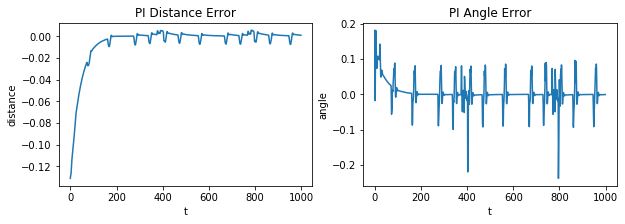

In [7]:
# Plot error

'''Plot distribution'''
plt.figure(figsize = (10,3))

plt.subplot(121)
plt.plot(error_dist)
plt.xlabel('t')
plt.ylabel('distance')
plt.title('PI Distance Error')

plt.subplot(122)
plt.plot(error_angle)
plt.xlabel('t')
plt.ylabel('angle')
plt.title('PI Angle Error')

plt.show()

## Part 2: Pure Pursuit

Within **03-control.txt**, answer the following question:

*While robust, general, and simple, PID controllers also have limitations. What are some failure cases of PID controllers?*
 
In this section, we'll be looking into a type of controller known as a *Pure Pursuit* (PP) controller. A PP controller is not explicitly a reactive controller, but actually requires a reference trajectory that the controller follows. When we input the pose, velocity, and current waypoint, the controller outputs control commands that are used to steer the robot.

Besides robot-specific parameters (which need to be set only once), a PP controller has a single, tunable parameter: *look-ahead* distance. The look-ahead distance is how far along the current path (more on how we do this next section) the robot should _look ahead_ from to compute the angular velocity commands. For simplicity, in our example, the velocity will be fixed.

Before we move on to the code, write the answer to the following in **03-control.txt**:

*Recall the lecture notes about PP controllers. How does the look-ahead distance affect performance? What does a small look-ahead distance prioritize? What about a larger one?*

*** 

As we start the last practical portion of the exercise, we recall a requirement of the PP controller: a reference trajectory. How can we get this from the simulator?

The answer lies inside of the `simulator.py` code, available [here](https://github.com/duckietown/gym-duckietown/blob/master/gym_duckietown/simulator.py). In `gym-duckietown`, we load every tile with a *Bezier* curve, which allows us to calculate a *reward* (useful in reinforcement learning, which we will see later). Each Bezier curve was designed to perfectly fit the right lane of each tile.

`gym-duckietown` provides a few helper functions that we will make use of. Inside of `controller.py:Controller:pure_pursuit`, you will notice a call to `closest_curve_point`, which returns the closest point on the reference trajectory. 

While we have a boilerplate function written, it still needs work. In particular, the main things that need your attention are:

- `follow_point` needs to be a function of a few more items, not just the closest point.
- Once you have the correct waypoint, you need to calculate the $\omega$ that gets you there. You can also change $v$ to go as fast as possible.


In [10]:
from notebooks.code.exercise_03_control.controller import Controller

# Reset environment
local_env = launch_env()
local_env = SteeringToWheelVelWrapper(wrap_env(local_env))
local_env.reset()
local_env.robot_speed = 0.5
controller = Controller()
total_reward = 0             
    
# Starting to drive
error_dist = []
error_angle = []
velocities = []
omegas = []

error_dist_from_sim = []
error_angle_from_sim = []

follow_dist = 1.5

for _ in range(1000):
   
    # Getting the global pose
    pos = local_env.cur_pos
    angle = local_env.cur_angle
    
    # Control
    v, omega, crosstrack_error, angle_error = controller.pure_pursuit(local_env, pos, angle, follow_dist=follow_dist)
    
    commands = np.array([v, omega])
    
    # Store data to plot
    error_dist.append(crosstrack_error)
    error_angle.append(angle_error)
    velocities.append(v)
    omegas.append(omega)
    
    lane_pos = local_env.get_lane_pos2(local_env.cur_pos,local_env.cur_angle)
    error_dist_from_sim.append(lane_pos.dist)
    error_angle_from_sim.append(lane_pos.angle_rad)
    
    # Step
    _, r, d, _ = local_env.step(commands)
    total_reward += r
    
    if d: 
        print("Duckiebot crashed.")
        break
        
local_env.close()

00:24:24|gym-duckietown|graphics.py:125|create_frame_buffers(): Falling back to non-multisampled frame buffer
00:24:24|gym-duckietown|graphics.py:125|create_frame_buffers(): Falling back to non-multisampled frame buffer
00:24:24|gym-duckietown|simulator.py:535|_load_map(): loading map file "/duckietown/simulation/gym_duckietown/maps/loop_empty.yaml"
00:24:24|gym-duckietown|simulator.py:1092|_drivable_pos(): [4.13719561 0.         1.88880899] corresponds to tile at (7, 3) which is not drivable: {'coords': (7, 3), 'kind': 'floor', 'angle': 0, 'drivable': False, 'texture': <simulation.gym_duckietown.graphics.Texture object at 0x7f36050bce10>, 'color': array([1, 1, 1])}
00:24:24|gym-duckietown|simulator.py:1202|_valid_pose(): Invalid pose. Collision free: True On drivable area: False
00:24:24|gym-duckietown|simulator.py:1203|_valid_pose(): safety_factor: 1.3
00:24:24|gym-duckietown|simulator.py:1204|_valid_pose(): pos: [4.0873995 0.        1.9726338]
00:24:24|gym-duckietown|simulator.py:12

00:24:24|gym-duckietown|simulator.py:1202|_valid_pose(): Invalid pose. Collision free: True On drivable area: False
00:24:24|gym-duckietown|simulator.py:1203|_valid_pose(): safety_factor: 1.3
00:24:24|gym-duckietown|simulator.py:1204|_valid_pose(): pos: [3.57292165 0.         1.88314807]
00:24:24|gym-duckietown|simulator.py:1205|_valid_pose(): l_pos: [3.48172154 0.         1.84866924]
00:24:24|gym-duckietown|simulator.py:1206|_valid_pose(): r_pos: [3.66412176 0.         1.91762689]
00:24:24|gym-duckietown|simulator.py:1207|_valid_pose(): f_pos: [3.61429624 0.         1.77370793]
00:24:24|gym-duckietown|simulator.py:1092|_drivable_pos(): [3.50690495 0.         2.23654429] corresponds to tile at (5, 3) which is not drivable: {'coords': (5, 3), 'kind': 'floor', 'angle': 0, 'drivable': False, 'texture': <simulation.gym_duckietown.graphics.Texture object at 0x7f36050bce10>, 'color': array([1, 1, 1])}
00:24:24|gym-duckietown|simulator.py:1202|_valid_pose(): Invalid pose. Collision free: True

00:24:25|gym-duckietown|simulator.py:1207|_valid_pose(): f_pos: [3.50609039 0.         2.05544313]
00:24:25|gym-duckietown|simulator.py:1092|_drivable_pos(): [4.12972415 0.         2.27350789] corresponds to tile at (7, 3) which is not drivable: {'coords': (7, 3), 'kind': 'floor', 'angle': 0, 'drivable': False, 'texture': <simulation.gym_duckietown.graphics.Texture object at 0x7f36050bce10>, 'color': array([1, 1, 1])}
00:24:25|gym-duckietown|simulator.py:1202|_valid_pose(): Invalid pose. Collision free: True On drivable area: False
00:24:25|gym-duckietown|simulator.py:1203|_valid_pose(): safety_factor: 1.3
00:24:25|gym-duckietown|simulator.py:1204|_valid_pose(): pos: [4.022444   0.         2.32019802]
00:24:25|gym-duckietown|simulator.py:1205|_valid_pose(): l_pos: [3.98353555 0.         2.23079789]
00:24:25|gym-duckietown|simulator.py:1206|_valid_pose(): r_pos: [4.06135244 0.         2.40959815]
00:24:25|gym-duckietown|simulator.py:1207|_valid_pose(): f_pos: [4.12972415 0.         2.27

00:24:29|gym-duckietown|simulator.py:1092|_drivable_pos(): [2.28873639 0.         2.68406941] corresponds to tile at (3, 4) which is not drivable: {'coords': (3, 4), 'kind': 'floor', 'angle': 0, 'drivable': False, 'texture': <simulation.gym_duckietown.graphics.Texture object at 0x7f36050bce10>, 'color': array([1, 1, 1])}
00:24:29|gym-duckietown|simulator.py:1202|_valid_pose(): Invalid pose. Collision free: True On drivable area: False
00:24:29|gym-duckietown|simulator.py:1203|_valid_pose(): safety_factor: 1.3
00:24:29|gym-duckietown|simulator.py:1204|_valid_pose(): pos: [2.38071712 0.         2.71640816]
00:24:29|gym-duckietown|simulator.py:1205|_valid_pose(): l_pos: [2.28873639 0.         2.68406941]
00:24:29|gym-duckietown|simulator.py:1206|_valid_pose(): r_pos: [2.47269785 0.         2.74874692]
00:24:29|gym-duckietown|simulator.py:1207|_valid_pose(): f_pos: [2.41952363 0.         2.60603129]
00:24:29|gym-duckietown|simulator.py:516|reset(): Starting at [2.64153703 0.         2.8846

00:24:30|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.16479374 0.         3.06472665] angle 3.088656879770614
00:24:30|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.16479374 0.         3.06472665] angle 3.088656879770614
00:24:30|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.14153417 0.         3.06346567] angle 3.0862078808991797
00:24:30|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.14153417 0.         3.06346567] angle 3.0862078808991797
00:24:30|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.11827758 0.         3.06215069] angle 3.084013416184266
00:24:30|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.11827758 0.         3.06215069] angle 3.084013416184266
00:24:30|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.09502386 0.         3.060786  ] angle 3.0819322303342886
00:24:30|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.09502386 0.         3.060786  ] angle 3.0819322303342886
00:24:30|gym-duckietown|simu

00:24:31|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.51329155 0.         3.05942392] angle 3.0548377505094018
00:24:31|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.51329155 0.         3.05942392] angle 3.0548377505094018
00:24:31|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.49009213 0.         3.05733028] angle 3.048344051230126
00:24:31|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.49009213 0.         3.05733028] angle 3.048344051230126
00:24:31|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.46690677 0.         3.05508637] angle 3.0418791492566264
00:24:31|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.46690677 0.         3.05508637] angle 3.0418791492566264
00:24:31|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.44373661 0.         3.05269065] angle 3.035245270968543
00:24:31|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.44373661 0.         3.05269065] angle 3.035245270968543
00:24:31|gym-duckietown|simu

00:24:32|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.02721288 0.         2.81200373] angle 1.599194236591776
00:24:32|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.02721288 0.         2.81200373] angle 1.599194236591776
00:24:32|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.02658807 0.         2.78871838] angle 1.5960513095368127
00:24:32|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.02658807 0.         2.78871838] angle 1.5960513095368127
00:24:32|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.02602038 0.         2.76543157] angle 1.5942875739700921
00:24:32|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.02602038 0.         2.76543157] angle 1.5942875739700921
00:24:32|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.02548675 0.         2.74214395] angle 1.5931267294232254
00:24:32|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.02548675 0.         2.74214395] angle 1.5931267294232254
00:24:32|gym-duckietown|si

00:24:32|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.03182948 0.         2.16003526] angle 1.5182984295067758
00:24:32|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.03182948 0.         2.16003526] angle 1.5182984295067758
00:24:32|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.03307667 0.         2.13677494] angle 1.516159102530537
00:24:32|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.03307667 0.         2.13677494] angle 1.516159102530537
00:24:32|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.03437233 0.         2.11351727] angle 1.5141307981242669
00:24:32|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.03437233 0.         2.11351727] angle 1.5141307981242669
00:24:33|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.03571476 0.         2.09026226] angle 1.5121367356491193
00:24:33|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.03571476 0.         2.09026226] angle 1.5121367356491193
00:24:33|gym-duckietown|si

00:24:33|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.03678686 0.         1.50854361] angle 1.4842034706303766
00:24:33|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.03678686 0.         1.50854361] angle 1.4842034706303766
00:24:33|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.03888005 0.         1.48534416] angle 1.477425197305808
00:24:33|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.03888005 0.         1.48534416] angle 1.477425197305808
00:24:33|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.04112919 0.         1.46215931] angle 1.4707540450945
00:24:33|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.04112919 0.         1.46215931] angle 1.4707540450945
00:24:33|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.04352291 0.         1.43898892] angle 1.4649504965061297
00:24:33|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.04352291 0.         1.43898892] angle 1.4649504965061297
00:24:33|gym-duckietown|simulato

00:24:34|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.28801876 0.         1.02799586] angle 0.028036069798333788
00:24:34|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.28801876 0.         1.02799586] angle 0.028036069798333788
00:24:34|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.31130419 0.         1.0273743 ] angle 0.025337499715135315
00:24:34|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.31130419 0.         1.0273743 ] angle 0.025337499715135315
00:24:34|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.33459089 0.         1.02680189] angle 0.023814856930361734
00:24:34|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.33459089 0.         1.02680189] angle 0.023814856930361734
00:24:34|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.35787831 0.         1.0262596 ] angle 0.02274958200688753
00:24:34|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.35787831 0.         1.0262596 ] angle 0.02274958200688753
00:24:34|g

00:24:35|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.94012498 0.         1.01572559] angle 0.014655433162891994
00:24:35|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.94012498 0.         1.01572559] angle 0.014655433162891994
00:24:35|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.96341625 0.         1.01538693] angle 0.014423016478032092
00:24:35|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.96341625 0.         1.01538693] angle 0.014423016478032092
00:24:35|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.9867076  0.         1.01505373] angle 0.014186812288306896
00:24:35|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.9867076  0.         1.01505373] angle 0.014186812288306896
00:24:35|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.00999903 0.         1.01472595] angle 0.013957132214203699
00:24:35|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.00999903 0.         1.01472595] angle 0.013957132214203699
00:24:35

00:24:36|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.56869236 0.         1.02842321] angle -0.06218815131572812
00:24:36|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.59193962 0.         1.02989375] angle -0.06415580042995109
00:24:36|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.59193962 0.         1.02989375] angle -0.06415580042995109
00:24:36|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.61518394 0.         1.03141026] angle -0.06614429216229069
00:24:36|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.61518394 0.         1.03141026] angle -0.06614429216229069
00:24:36|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.63845672 0.         1.03233099] angle -0.01293984675215739
00:24:36|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.63845672 0.         1.03233099] angle -0.01293984675215739
00:24:36|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.66174957 0.         1.0322888 ] angle 0.016562585771524283
00:24:36

00:24:37|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.22001328 0.         1.03922698] angle -0.10489837814894126
00:24:37|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.24317188 0.         1.04173216] angle -0.11061284408343151
00:24:37|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.24317188 0.         1.04173216] angle -0.11061284408343151
00:24:37|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.26631899 0.         1.04434154] angle -0.11390036634955601
00:24:37|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.26631899 0.         1.04434154] angle -0.11390036634955601
00:24:37|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.28945165 0.         1.04707568] angle -0.12139568150244613
00:24:37|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.28945165 0.         1.04707568] angle -0.12139568150244613
00:24:37|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.31256426 0.         1.04997452] angle -0.1281458023753691
00:24:37|

00:24:38|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.64455714 0.         1.33632088] angle -1.6158007290833571
00:24:38|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.64346873 0.         1.35958916] angle -1.6192764325861346
00:24:38|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.64346873 0.         1.35958916] angle -1.6192764325861346
00:24:38|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.64230791 0.         1.38285394] angle -1.6220260984827506
00:24:38|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.64230791 0.         1.38285394] angle -1.6220260984827506
00:24:38|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.64108745 0.         1.40611568] angle -1.624403073629868
00:24:38|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.64108745 0.         1.40611568] angle -1.624403073629868
00:24:38|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.63981377 0.         1.42937456] angle -1.6266024704913462
00:24:38|gym-ducki

00:24:38|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.64345448 0.         1.98785815] angle -1.651281739663597
00:24:38|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.64150177 0.         2.01106985] angle -1.6581680002026378
00:24:39|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.64150177 0.         2.01106985] angle -1.6581680002026378
00:24:39|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.63939224 0.         2.03426782] angle -1.6647975055321202
00:24:39|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.63939224 0.         2.03426782] angle -1.6647975055321202
00:24:39|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.63712858 0.         2.05745126] angle -1.6714602155068505
00:24:39|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.63712858 0.         2.05745126] angle -1.6714602155068505
00:24:39|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.63473165 0.         2.08062132] angle -1.6762984410671038
00:24:39|gym-duck

00:24:39|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.41177608 0.         2.50355827] angle -3.03580760099263
00:24:39|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.38861558 0.         2.50604605] angle -3.033368302053243
00:24:39|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.38861558 0.         2.50604605] angle -3.033368302053243
00:24:39|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.36546614 0.         2.50863442] angle -3.027119597859418
00:24:39|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.36546614 0.         2.50863442] angle -3.027119597859418
00:24:39|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.34233158 0.         2.51135269] angle -3.0221411245234213
00:24:39|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.34233158 0.         2.51135269] angle -3.0221411245234213
00:24:39|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.31921909 0.         2.51425194] angle -3.011466596098814
00:24:39|gym-duckietown

00:24:40|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.77002102 0.         2.61091664] angle -2.8131899901030333
00:24:40|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.74798698 0.         2.61847299] angle -2.809252593501285
00:24:40|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.74798698 0.         2.61847299] angle -2.809252593501285
00:24:40|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.72597705 0.         2.6260993 ] angle -2.8068359859104475
00:24:40|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.72597705 0.         2.6260993 ] angle -2.8068359859104475
00:24:40|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.70398454 0.         2.63377572] angle -2.804698554235489
00:24:40|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.70398454 0.         2.63377572] angle -2.804698554235489
00:24:40|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.6820102  0.         2.64150397] angle -2.8021199524403486
00:24:40|gym-duckiet

00:24:41|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.37508944 0.         3.05461381] angle -2.8241043071530543
00:24:41|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.35252528 0.         3.06032152] angle -2.963565781823452
00:24:41|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.35252528 0.         3.06032152] angle -2.963565781823452
00:24:41|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.32944649 0.         3.06342145] angle -3.0525791961857047
00:24:41|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.32944649 0.         3.06342145] angle -3.0525791961857047
00:24:41|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.30619832 0.         3.06482568] angle -3.1099492027261735
00:24:41|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.30619832 0.         3.06482568] angle -3.1099492027261735
00:24:41|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.28290833 0.         3.06517959] angle -3.1428464987387734
00:24:41|gym-ducki

00:24:42|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.72435487 0.         3.0679763 ] angle -3.142906091687763
00:24:42|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.7010618  0.         3.06781659] angle -3.1539925145731846
00:24:42|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.7010618  0.         3.06781659] angle -3.1539925145731846
00:24:42|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.677772   0.         3.06739572] angle -3.1653309638821234
00:24:42|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.677772   0.         3.06739572] angle -3.1653309638821234
00:24:42|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.65448807 0.         3.06672343] angle -3.175584841654414
00:24:42|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.65448807 0.         3.06672343] angle -3.175584841654414
00:24:42|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.63121182 0.         3.06582309] angle -3.1849230628810554
00:24:42|gym-duckie

00:24:43|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.07736015 0.         3.0092697 ] angle -3.729917239978485
00:24:43|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.06008327 0.         2.99376439] angle -4.016087935922769
00:24:43|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.06008327 0.         2.99376439] angle -4.016087935922769
00:24:43|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.04764515 0.         2.97414845] angle -4.278482119000346
00:24:43|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.04764515 0.         2.97414845] angle -4.278482119000346
00:24:43|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.03980447 0.         2.95224743] angle -4.458719047500639
00:24:43|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.03980447 0.         2.95224743] angle -4.458719047500639
00:24:43|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.0351306  0.         2.92943795] angle -4.561836328053958
00:24:43|gym-duckietown|

00:24:44|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.02343811 0.         2.37077271] angle -4.738313493094757
00:24:44|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.02408964 0.         2.3474881 ] angle -4.74241197361285
00:24:44|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.02408964 0.         2.3474881 ] angle -4.74241197361285
00:24:44|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.02482957 0.         2.32420613] angle -4.74590741740174
00:24:44|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.02482957 0.         2.32420613] angle -4.74590741740174
00:24:44|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.02564763 0.         2.30092678] angle -4.749123383365183
00:24:44|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.02564763 0.         2.30092678] angle -4.749123383365183
00:24:44|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.02653938 0.         2.27765013] angle -4.7522387590972786
00:24:44|gym-duckietown|sim

00:24:45|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.02637319 0.         1.71914494] angle -4.717164065496994
00:24:45|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.02661799 0.         1.69585262] angle -4.7286336227836285
00:24:45|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.02661799 0.         1.69585262] angle -4.7286336227836285
00:24:45|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.02712609 0.         1.67256455] angle -4.739772820307103
00:24:45|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.02712609 0.         1.67256455] angle -4.739772820307103
00:24:45|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.02787609 0.         1.64928298] angle -4.749412139513251
00:24:45|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.02787609 0.         1.64928298] angle -4.749412139513251
00:24:45|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.02885064 0.         1.62600973] angle -4.75906520933088
00:24:45|gym-duckietown

00:24:45|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.0881222  0.         1.07280513] angle -5.349338345546157
00:24:45|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.10468379 0.         1.05679149] angle -5.679875007519252
00:24:45|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.10468379 0.         1.05679149] angle -5.679875007519252
00:24:45|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.12520037 0.         1.0458682 ] angle -5.908015276615423
00:24:45|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.12520037 0.         1.0458682 ] angle -5.908015276615423
00:24:45|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.14744855 0.         1.0390472 ] angle -6.063377253444405
00:24:45|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.14744855 0.         1.0390472 ] angle -6.063377253444405
00:24:45|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.17037575 0.         1.0349739 ] angle -6.1513385510404515
00:24:45|gym-duckietown

00:24:46|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.72908349 0.         1.01913459] angle -6.2661879113624135
00:24:46|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.75237391 0.         1.0187418 ] angle -6.26645608364638
00:24:46|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.75237391 0.         1.0187418 ] angle -6.26645608364638
00:24:46|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.77566443 0.         1.01835521] angle -6.266720308148686
00:24:46|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.77566443 0.         1.01835521] angle -6.266720308148686
00:24:46|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.79895506 0.         1.01797472] angle -6.266979965116312
00:24:46|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.79895506 0.         1.01797472] angle -6.266979965116312
00:24:46|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.82224579 0.         1.01760036] angle -6.267246637173681
00:24:46|gym-duckietown|s

00:24:47|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.38118664 0.         1.01851823] angle -6.325972770389823
00:24:47|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.40445758 0.         1.01954834] angle -6.328872429078562
00:24:47|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.40445758 0.         1.01954834] angle -6.328872429078562
00:24:47|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.42772558 0.         1.02064292] angle -6.331513242277198
00:24:47|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.42772558 0.         1.02064292] angle -6.331513242277198
00:24:47|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.45099045 0.         1.02180198] angle -6.334415288004722
00:24:47|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.45099045 0.         1.02180198] angle -6.334415288004722
00:24:47|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.4742522  0.         1.02302206] angle -6.336759696312659
00:24:47|gym-duckietown|

00:24:48|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.03281705 0.         1.02481538] angle -6.3260672597643826
00:24:48|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.05608406 0.         1.02592901] angle -6.3359564162296325
00:24:48|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.05608406 0.         1.02592901] angle -6.3359564162296325
00:24:48|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.07933964 0.         1.02726025] angle -6.34477675791989
00:24:48|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.07933964 0.         1.02726025] angle -6.34477675791989
00:24:48|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.10258288 0.         1.0287921 ] angle -6.353214383676461
00:24:48|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.10258288 0.         1.0287921 ] angle -6.353214383676461
00:24:48|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.12581301 0.         1.03051162] angle -6.360928487324795
00:24:48|gym-duckietown

00:24:49|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.6414794  0.         1.14907785] angle -7.647454035326769
00:24:49|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.64515432 0.         1.17207079] angle -7.743533168875528
00:24:49|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.64515432 0.         1.17207079] angle -7.743533168875528
00:24:49|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.64695964 0.         1.19529026] angle -7.809242019905733
00:24:49|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.64695964 0.         1.19529026] angle -7.809242019905733
00:24:49|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.64756484 0.         1.21857477] angle -7.8467500291085415
00:24:49|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.64756484 0.         1.21857477] angle -7.8467500291085415
00:24:49|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.64748145 0.         1.2418679 ] angle -7.868373158354103
00:24:49|gym-duckietow

00:24:50|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.65222263 0.         1.80041771] angle -7.86144867247655
00:24:50|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.65191511 0.         1.82370929] angle -7.872918786567917
00:24:50|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.65191511 0.         1.82370929] angle -7.872918786567917
00:24:50|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.65135505 0.         1.84699618] angle -7.883136081128084
00:24:50|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.65135505 0.         1.84699618] angle -7.883136081128084
00:24:50|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.65056189 0.         1.87027632] angle -7.892941697192128
00:24:50|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.65056189 0.         1.87027632] angle -7.892941697192128
00:24:50|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.64954692 0.         1.89354784] angle -7.9021948663481085
00:24:50|gym-duckietown|

00:24:50|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.58539574 0.         2.44486278] angle -8.607504822594235
00:24:50|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.56818229 0.         2.46052046] angle -8.765843099004963
00:24:50|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.56818229 0.         2.46052046] angle -8.765843099004963
00:24:50|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.54904038 0.         2.47377455] angle -8.872482448465663
00:24:50|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.54904038 0.         2.47377455] angle -8.872482448465663
00:24:50|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.5280795  0.         2.48383732] angle -9.081913327890824
00:24:50|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.5280795  0.         2.48383732] angle -9.081913327890824
00:24:50|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.50572794 0.         2.49034624] angle -9.200902955440881
00:24:51|gym-duckietown|

00:24:51|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.95356886 0.         2.57383757] angle -9.331631842431047
00:24:51|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.9303903  0.         2.57614953] angle -9.319090846336376
00:24:51|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.9303903  0.         2.57614953] angle -9.319090846336376
00:24:51|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.90723598 0.         2.57869374] angle -9.311581853377596
00:24:51|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.90723598 0.         2.57869374] angle -9.311581853377596
00:24:51|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.88416625 0.         2.58189908] angle -9.261859420952073
00:24:51|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.88416625 0.         2.58189908] angle -9.261859420952073
00:24:51|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.86129261 0.         2.58628834] angle -9.20852206741018
00:24:51|gym-duckietown|s

00:24:52|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.443489   0.         2.89807789] angle -7.958305539373808
00:24:52|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.44161253 0.         2.92129374] angle -7.910960862956699
00:24:52|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.44161253 0.         2.92129374] angle -7.910960862956699
00:24:52|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.44079643 0.         2.9445713 ] angle -7.867092542342017
00:24:52|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.44079643 0.         2.9445713 ] angle -7.867092542342017
00:24:52|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.43951855 0.         2.96782317] angle -7.950676435144892
00:24:52|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.43951855 0.         2.96782317] angle -7.950676435144892
00:24:52|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.43568147 0.         2.99078001] angle -8.088511757680232
00:24:52|gym-duckietown|

00:24:53|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.91001335 0.         3.06147546] angle -9.370984405979797
00:24:53|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.88675272 0.         3.06271698] angle -9.371924577453598
00:24:53|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.88675272 0.         3.06271698] angle -9.371924577453598
00:24:53|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.86349015 0.         3.06392137] angle -9.374176174540834
00:24:53|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.86349015 0.         3.06392137] angle -9.374176174540834
00:24:53|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.84022386 0.         3.06505144] angle -9.37831337458652
00:24:53|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.84022386 0.         3.06505144] angle -9.37831337458652
00:24:53|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.81695192 0.         3.06605773] angle -9.38481589781961
00:24:53|gym-duckietown|sim

00:24:54|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.25947134 0.         3.03416435] angle -9.445896680280885
00:24:54|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.23618329 0.         3.03364996] angle -9.447828532869128
00:24:54|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.23618329 0.         3.03364996] angle -9.447828532869128
00:24:54|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.21290033 0.         3.03294807] angle -9.462001699996257
00:24:54|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.21290033 0.         3.03294807] angle -9.462001699996257
00:24:54|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.18963016 0.         3.03190554] angle -9.47709637229954
00:24:54|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.18963016 0.         3.03190554] angle -9.47709637229954
00:24:54|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.16638129 0.         3.03046619] angle -9.49612246282295
00:24:54|gym-duckietown|sim

00:24:55|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.0223556  0.         2.55630172] angle -10.982181986985523
00:24:55|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.02209295 0.         2.53300949] angle -10.986415218425034
00:24:55|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.02209295 0.         2.53300949] angle -10.986415218425034
00:24:55|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.0219395  0.         2.50971628] angle -10.991558181730912
00:24:55|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.0219395  0.         2.50971628] angle -10.991558181730912
00:24:55|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.0219101 0.        2.4864226] angle -10.997065773390275
00:24:55|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.0219101 0.        2.4864226] angle -10.997065773390275
00:24:55|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.02201005 0.         2.46312911] angle -11.002664383512489
00:24:55|gym-duckietow

00:24:56|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.03256806 0.         1.90456464] angle -10.94311717390363
00:24:56|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.03135779 0.         1.88130237] angle -10.944070514238899
00:24:56|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.03135779 0.         1.88130237] angle -10.944070514238899
00:24:56|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.03018822 0.         1.85803802] angle -10.946616136981453
00:24:56|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.03018822 0.         1.85803802] angle -10.946616136981453
00:24:56|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.02910083 0.         1.8347697 ] angle -10.95113530750397
00:24:56|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.02910083 0.         1.8347697 ] angle -10.95113530750397
00:24:56|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.02814687 0.         1.81149555] angle -10.95808331341568
00:24:56|gym-duckiet

00:24:56|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.06151182 0.         1.25409685] angle -11.016084824183537
00:24:56|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.06204284 0.         1.23080919] angle -11.020661140081497
00:24:56|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.06204284 0.         1.23080919] angle -11.020661140081497
00:24:56|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.06277102 0.         1.20752699] angle -11.033019781513389
00:24:56|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.06277102 0.         1.20752699] angle -11.033019781513389
00:24:56|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.063833   0.         1.18425774] angle -11.049343367052868
00:24:56|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.063833   0.         1.18425774] angle -11.049343367052868
00:24:57|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.06531928 0.         1.16101186] angle -11.069505556078655
00:24:57|gym-duc

00:24:57|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.54369129 0.         1.02243625] angle -12.547082187075924
00:24:57|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.56698076 0.         1.02199067] angle -12.547398376134485
00:24:57|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.56698076 0.         1.02199067] angle -12.547398376134485
00:24:57|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.59027036 0.         1.02155156] angle -12.547639025195414
00:24:57|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.59027036 0.         1.02155156] angle -12.547639025195414
00:24:57|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.61356008 0.         1.02111903] angle -12.54796278828628
00:24:57|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.61356008 0.         1.02111903] angle -12.54796278828628
00:24:57|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.63684994 0.         1.02069456] angle -12.548331890598257
00:24:57|gym-ducki

00:24:58|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.19584287 0.         1.01339448] angle -12.574415831904044
00:24:58|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.21913506 0.         1.0136595 ] angle -12.58108018783756
00:24:58|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.21913506 0.         1.0136595 ] angle -12.58108018783756
00:24:58|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.2424254  0.         1.01405574] angle -12.585683885191768
00:24:58|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.2424254  0.         1.01405574] angle -12.585683885191768
00:24:58|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.26571369 0.         1.01455853] angle -12.590230697391807
00:24:58|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.26571369 0.         1.01455853] angle -12.590230697391807
00:24:58|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.2889995  0.         1.01516524] angle -12.594608320996162
00:24:58|gym-ducki

00:24:59|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.8474479  0.         1.02480509] angle -12.52865613685361
00:24:59|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.87072793 0.         1.02400776] angle -12.535613142186929
00:24:59|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.87072793 0.         1.02400776] angle -12.535613142186929
00:24:59|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.89401355 0.         1.02339566] angle -12.544566896159155
00:24:59|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.89401355 0.         1.02339566] angle -12.544566896159155
00:24:59|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.91730402 0.         1.02301284] angle -12.555303978782524
00:24:59|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.91730402 0.         1.02301284] angle -12.555303978782524
00:24:59|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.94059728 0.         1.02288384] angle -12.566360645226553
00:24:59|gym-duck

To see qualitatively how you are doing:

In [11]:
print("Your score: {}".format(total_reward))
view_results_ipython(local_env)

Your score: 296.8828452587528


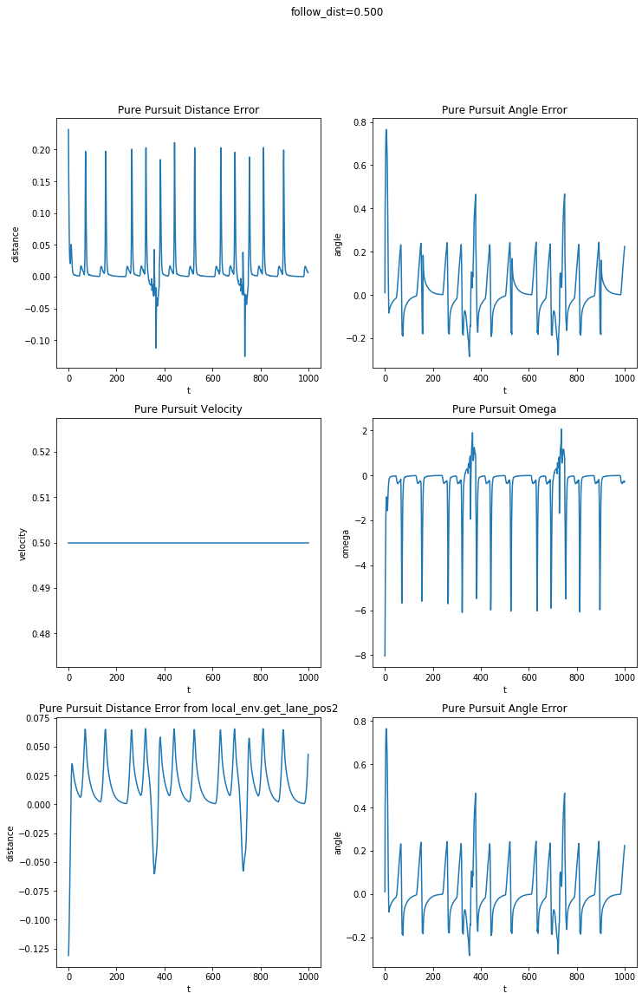

In [26]:
# Plot

'''Plot distribution'''
fig = plt.figure(figsize = (12,18))
fig.suptitle('follow_dist=%.3f' % follow_dist)

plt.subplot(321)
plt.plot(error_dist)
plt.xlabel('t')
plt.ylabel('distance')
plt.title('Pure Pursuit Distance Error')

plt.subplot(322)
plt.plot(error_angle)
plt.xlabel('t')
plt.ylabel('angle')
plt.title('Pure Pursuit Angle Error')

plt.subplot(323)
plt.plot(velocities)
plt.xlabel('t')
plt.ylabel('velocity')
plt.title('Pure Pursuit Velocity')

plt.subplot(324)
plt.plot(omegas)
plt.xlabel('t')
plt.ylabel('omega')
plt.title('Pure Pursuit Omega')

plt.subplot(325)
plt.plot(error_dist_from_sim)
plt.xlabel('t')
plt.ylabel('distance')
plt.title('Pure Pursuit Distance Error from local_env.get_lane_pos2')

plt.subplot(326)
plt.plot(error_angle_from_sim)
plt.xlabel('t')
plt.ylabel('angle')
plt.title('Pure Pursuit Angle Error')

plt.show()

For this portion of the exercise, submit one plot with **cross-track error**, **angle error**, **commanded linear velocity** and **commanded angular velocity** vs. time. Lastly, experiment with the `lookup_distance` hyperparameter; does the lowering / raising this value match your hypothesis from earlier in this exercise?

Please submit the plot, `controller.py`, and `control.txt` inside of the zip file, and upload it to the Software submission link posted on Piazza.